<a href="https://colab.research.google.com/github/Adl1coder/san-francisco-crime-analysis/blob/main/SanFransisco.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler


In [ ]:
df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")
df.head()


,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y
0,2015-05-13 23:53:00,WARRANTS,WARRANT ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
1,2015-05-13 23:53:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
2,2015-05-13 23:33:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",VANNESS AV / GREENWICH ST,-122.424363,37.800414
3,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873
4,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541


In [ ]:

df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis = 1)


In [ ]:
df.tail(5)

,Dates,Category,X,Y
878044,2003-01-06 00:15:00,ROBBERY,-122.459033,37.714056
878045,2003-01-06 00:01:00,LARCENY/THEFT,-122.447364,37.731948
878046,2003-01-06 00:01:00,LARCENY/THEFT,-122.403390,37.780266
878047,2003-01-06 00:01:00,VANDALISM,-122.390531,37.780607
878048,2003-01-06 00:01:00,FORGERY/COUNTERFEITING,-122.394926,37.738212


In [ ]:
df.isnull().sum()

Dates       0
Category    0
X           0
Y           0
dtype: int64

In [ ]:
f = lambda x: (x["Dates"].split())[0]
df["Dates"] = df.apply(f, axis=1)
df.head()

,Dates,Category,X,Y
0,2015-05-13,WARRANTS,-122.425892,37.774599
1,2015-05-13,OTHER OFFENSES,-122.425892,37.774599
2,2015-05-13,OTHER OFFENSES,-122.424363,37.800414
3,2015-05-13,LARCENY/THEFT,-122.426995,37.800873
4,2015-05-13,LARCENY/THEFT,-122.438738,37.771541


In [ ]:
f = lambda x: (x["Dates"].split('-'))[0]
df["Dates"] = df.apply(f, axis=1)
df.head()

,Dates,Category,X,Y
0,2015,WARRANTS,-122.425892,37.774599
1,2015,OTHER OFFENSES,-122.425892,37.774599
2,2015,OTHER OFFENSES,-122.424363,37.800414
3,2015,LARCENY/THEFT,-122.426995,37.800873
4,2015,LARCENY/THEFT,-122.438738,37.771541


In [ ]:
df.tail()

,Dates,Category,X,Y
878044,2003,ROBBERY,-122.459033,37.714056
878045,2003,LARCENY/THEFT,-122.447364,37.731948
878046,2003,LARCENY/THEFT,-122.403390,37.780266
878047,2003,VANDALISM,-122.390531,37.780607
878048,2003,FORGERY/COUNTERFEITING,-122.394926,37.738212


In [ ]:
df_2014 = df[(df.Dates == '2014')]
df_2014.head()

,Dates,Category,X,Y
27584,2014,LARCENY/THEFT,-122.435563,37.760801
27585,2014,LARCENY/THEFT,-122.433575,37.800037
27586,2014,VEHICLE THEFT,-122.412777,37.786834
27587,2014,ASSAULT,-122.421702,37.773641
27588,2014,ASSAULT,-122.421702,37.773641


In [ ]:
scaler = MinMaxScaler()

In [ ]:
scaler.fit(df_2014[['X']])
df_2014['X_scaled'] = scaler.transform(df_2014[['X']])




<ipython-input-12-66a6b38848e6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014['X_scaled'] = scaler.transform(df_2014[['X']])


In [ ]:
scaler.fit(df_2014[['Y']])
df_2014['Y_scaled'] = scaler.transform(df_2014[['Y']])

<ipython-input-13-cae988f185e3>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014['Y_scaled'] = scaler.transform(df_2014[['Y']])


In [ ]:
df_2014.head()

,Dates,Category,X,Y,X_scaled,Y_scaled
27584,2014,LARCENY/THEFT,-122.435563,37.760801,0.526134,0.471397
27585,2014,LARCENY/THEFT,-122.433575,37.800037,0.539528,0.821894
27586,2014,VEHICLE THEFT,-122.412777,37.786834,0.679676,0.703952
27587,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098
27588,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098


In [ ]:
k_range = range(1,15)

list_dist = []

for k in k_range:
    model = KMeans(n_clusters=k)
    model.fit(df_2014[['X_scaled','Y_scaled']])
    list_dist.append(model.inertia_)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

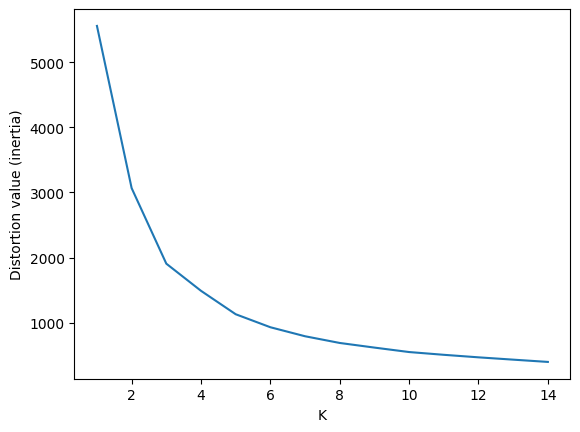

In [ ]:
from matplotlib import pyplot as plt

plt.xlabel('K')
plt.ylabel('Distortion value (inertia)')
plt.plot(k_range,list_dist)
plt.show()

In [ ]:
model = KMeans(n_clusters=5)
y_predicted = model.fit_predict(df_2014[['X_scaled','Y_scaled']])
y_predicted

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([0, 1, 1, ..., 1, 3, 1], dtype=int32)

In [ ]:
df_2014['cluster'] = y_predicted
df_2014


<ipython-input-18-e054145cfda4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014['cluster'] = y_predicted


,Dates,Category,X,Y,X_scaled,Y_scaled,cluster
27584,2014,LARCENY/THEFT,-122.435563,37.760801,0.526134,0.471397,0
27585,2014,LARCENY/THEFT,-122.433575,37.800037,0.539528,0.821894,1
27586,2014,VEHICLE THEFT,-122.412777,37.786834,0.679676,0.703952,1
27587,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098,0
27588,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098,0
...,...,...,...,...,...,...,...
102345,2014,OTHER OFFENSES,-122.387235,37.719401,0.851793,0.101571,3
102346,2014,WARRANTS,-122.387235,37.719401,0.851793,0.101571,3
102347,2014,FRAUD,-122.418382,37.783258,0.641908,0.672007,1
102348,2014,NON-CRIMINAL,-122.413652,37.728320,0.673778,0.181249,3


In [ ]:
import plotly.express as px

In [ ]:
figure = px.scatter_mapbox(df_2014, lat='Y', lon='X',
                       center = dict(lat = 37.8, lon = -122.4),
                       zoom = 9,
                       opacity = .9,
                       mapbox_style = 'stamen-terrain',
                       color = 'cluster',
                       title = 'San Francisco Crime Districts',
                       width = 1100,
                       height = 700,
                       hover_data = ['cluster', 'Category', 'Y', 'X']
                       )

figure.show()

In [ ]:
from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import numpy as np
import plotly.express as px

# Veri yüklemesi
df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")

# Gereksiz sütunları çıkar
df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis=1)

# Tarih formatını düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split()[0])
df["Dates"] = df["Dates"].apply(lambda x: x.split('-')[0])

# 2014 verilerini seç
df_2014 = df[df["Dates"] == '2014']

# Kategorik değişkenleri sayısal değerlere dönüştür
df_2014['Category'] = df_2014['Category'].astype('category')
df_2014['Category_code'] = df_2014['Category'].cat.codes

# Veriyi ölçeklendir
scaler = MinMaxScaler()
df_2014[['X_scaled', 'Y_scaled']] = scaler.fit_transform(df_2014[['X', 'Y']])

# K-Means modeli oluştur ve kümeleme yap
kmeans = KMeans(n_clusters=5, random_state=42)
df_2014['cluster'] = kmeans.fit_predict(df_2014[['X_scaled', 'Y_scaled']])

# Küme ve etiket eşlemesi
# Her küme için çoğunluk etiketi belirleme
labels = np.zeros_like(df_2014['cluster'])
for i in range(5):
    mask = (df_2014['cluster'] == i)
    labels[mask] = df_2014[mask]['Category_code'].mode()

# Model değerlendirme
y_true = df_2014['Category_code']
y_pred_kmeans = labels

accuracy_kmeans = accuracy_score(y_true, y_pred_kmeans)
precision_kmeans = precision_score(y_true, y_pred_kmeans, average='weighted')
recall_kmeans = recall_score(y_true, y_pred_kmeans, average='weighted')
f1_kmeans = f1_score(y_true, y_pred_kmeans, average='weighted')
conf_matrix_kmeans = confusion_matrix(y_true, y_pred_kmeans)
class_report_kmeans = classification_report(y_true, y_pred_kmeans, target_names=df_2014['Category'].cat.categories)

print(f"Accuracy (K-Means): {accuracy_kmeans}")
print(f"Precision (K-Means): {precision_kmeans}")
print(f"Recall (K-Means): {recall_kmeans}")
print(f"F1 Score (K-Means): {f1_kmeans}")
print("\nConfusion Matrix (K-Means):\n", conf_matrix_kmeans)
print("\nClassification Report (K-Means):\n", class_report_kmeans)

# Haritayı çiz
df_2014['predicted_category'] = labels
figure = px.scatter_mapbox(df_2014, lat='Y', lon='X',
                           center=dict(lat=37.8, lon=-122.4),
                           zoom=9,
                           opacity=0.9,
                           mapbox_style='stamen-terrain',
                           color='predicted_category',
                           title='San Francisco Crime Districts (K-Means)',
                           width=1100,
                           height=700,
                           hover_data=['predicted_category', 'Category', 'Y', 'X'])

figure.show()


<ipython-input-25-31a93ca301f2>:22: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-25-31a93ca301f2>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-25-31a93ca301f2>:27: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-25-31a9

Accuracy (K-Means): 0.2621378701548832
Precision (K-Means): 0.09598629799326583
Recall (K-Means): 0.2621378701548832
F1 Score (K-Means): 0.12994916799601036

Confusion Matrix (K-Means):
 [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

Classification Report (K-Means):
                              precision    recall  f1-score   support

                      ARSON       0.00      0.00      0.00       115
                    ASSAULT       0.00      0.00      0.00      6254
                 BAD CHECKS       0.00      0.00      0.00        12
                    BRIBERY       0.00      0.00      0.00        26
                   BURGLARY       0.00      0.00      0.00      3006
         DISORDERLY CONDUCT       0.00      0.00      0.00       171
DRIVING UNDER THE INFLUENCE       0.00      0.00      0.00       184
              DRUG/NARCOTIC       0.00      0.00      0.00      2767
                DRUNKENNESS       0.

<ipython-input-30-1cb8ed368d03>:27: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-30-1cb8ed368d03>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-30-1cb8ed368d03>:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-30-1cb8

Accuracy (K-Means): 0.2621378701548832
Precision (K-Means): 0.09598629799326583
Recall (K-Means): 0.2621378701548832
F1 Score (K-Means): 0.12994916799601036

Confusion Matrix (K-Means):
 [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

Classification Report (K-Means):
                              precision    recall  f1-score   support

                      ARSON       0.00      0.00      0.00       115
                    ASSAULT       0.00      0.00      0.00      6254
                 BAD CHECKS       0.00      0.00      0.00        12
                    BRIBERY       0.00      0.00      0.00        26
                   BURGLARY       0.00      0.00      0.00      3006
         DISORDERLY CONDUCT       0.00      0.00      0.00       171
DRIVING UNDER THE INFLUENCE       0.00      0.00      0.00       184
              DRUG/NARCOTIC       0.00      0.00      0.00      2767
                DRUNKENNESS       0.

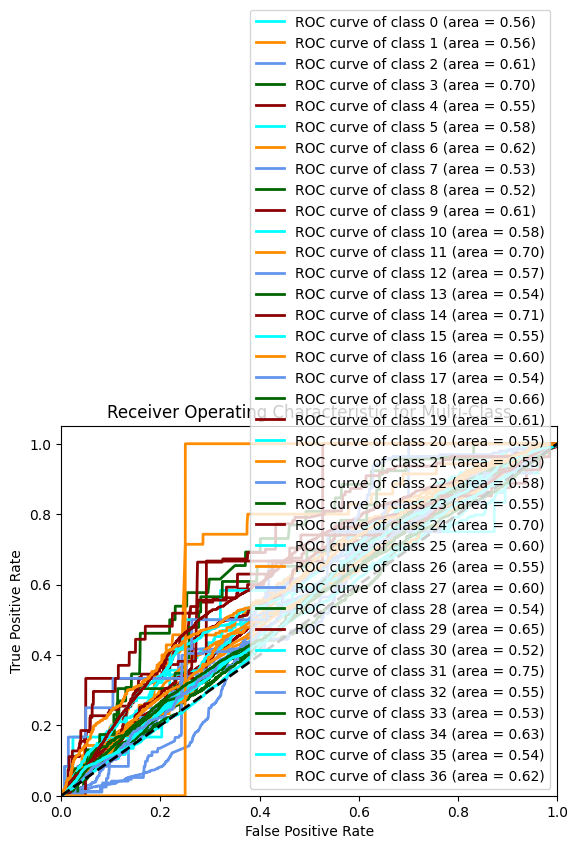

<ipython-input-30-1cb8ed368d03>:98: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from sklearn.linear_model import LogisticRegression
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from itertools import cycle

# Veri yüklemesi
df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")

# Gereksiz sütunları çıkar
df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis=1)

# Tarih formatını düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split()[0])
df["Dates"] = df["Dates"].apply(lambda x: x.split('-')[0])

# 2014 verilerini seç
df_2014 = df[df["Dates"] == '2014']

# Kategorik değişkenleri sayısal değerlere dönüştür
df_2014['Category'] = df_2014['Category'].astype('category')
df_2014['Category_code'] = df_2014['Category'].cat.codes

# Veriyi ölçeklendir
scaler = MinMaxScaler()
df_2014[['X_scaled', 'Y_scaled']] = scaler.fit_transform(df_2014[['X', 'Y']])

# K-Means modeli oluştur ve kümeleme yap
kmeans = KMeans(n_clusters=5, random_state=42)
df_2014['cluster'] = kmeans.fit_predict(df_2014[['X_scaled', 'Y_scaled']])

# Küme ve etiket eşlemesi
# Her küme için çoğunluk etiketi belirleme
labels = np.zeros_like(df_2014['cluster'])
for i in range(5):
    mask = (df_2014['cluster'] == i)
    labels[mask] = df_2014[mask]['Category_code'].mode()[0]

# Model değerlendirme
y_true = df_2014['Category_code']
y_pred_kmeans = labels

accuracy_kmeans = accuracy_score(y_true, y_pred_kmeans)
precision_kmeans = precision_score(y_true, y_pred_kmeans, average='weighted')
recall_kmeans = recall_score(y_true, y_pred_kmeans, average='weighted')
f1_kmeans = f1_score(y_true, y_pred_kmeans, average='weighted')
conf_matrix_kmeans = confusion_matrix(y_true, y_pred_kmeans)
class_report_kmeans = classification_report(y_true, y_pred_kmeans, target_names=df_2014['Category'].cat.categories)

print(f"Accuracy (K-Means): {accuracy_kmeans}")
print(f"Precision (K-Means): {precision_kmeans}")
print(f"Recall (K-Means): {recall_kmeans}")
print(f"F1 Score (K-Means): {f1_kmeans}")
print("\nConfusion Matrix (K-Means):\n", conf_matrix_kmeans)
print("\nClassification Report (K-Means):\n", class_report_kmeans)

# ROC Eğrisi ve AUC hesaplama
# Kategorileri binarize etme
y_true_binarized = label_binarize(y_true, classes=np.arange(len(df_2014['Category'].cat.categories)))
n_classes = y_true_binarized.shape[1]

# Sınıflandırıcıyı OneVsRestClassifier ile eğitme
classifier = OneVsRestClassifier(LogisticRegression(solver='lbfgs'))
y_score = classifier.fit(df_2014[['X_scaled', 'Y_scaled']], y_true_binarized).predict_proba(df_2014[['X_scaled', 'Y_scaled']])

# ROC Eğrisi ve AUC hesaplama
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_true_binarized[:, i], y_score[:, i])
    roc_auc[i] = roc_auc_score(y_true_binarized[:, i], y_score[:, i])

# Her sınıf için ROC eğrilerini çizme
colors = cycle(['aqua', 'darkorange', 'cornflowerblue', 'darkgreen', 'darkred'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
                   ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic for Multi-Class')
plt.legend(loc="lower right")
plt.show()

# Haritayı çiz
df_2014['predicted_category'] = labels
figure = px.scatter_mapbox(df_2014, lat='Y', lon='X',
                           center=dict(lat=37.8, lon=-122.4),
                           zoom=9,
                           opacity=0.9,
                           mapbox_style='stamen-terrain',
                           color='predicted_category',
                           title='San Francisco Crime Districts (K-Means)',
                           width=1100,
                           height=700,
                           hover_data=['predicted_category', 'Category', 'Y', 'X'])

figure.show()


In [ ]:
import plotly
plotly.offline.plot(figure, filename = 'maptest.html', auto_open = True)


'maptest.html'

In [ ]:
help(px.scatter_mapbox)

Help on function scatter_mapbox in module plotly.express._chart_types:

scatter_mapbox(data_frame=None, lat=None, lon=None, color=None, text=None, hover_name=None, hover_data=None, custom_data=None, size=None, animation_frame=None, animation_group=None, category_orders=None, labels=None, color_discrete_sequence=None, color_discrete_map=None, color_continuous_scale=None, range_color=None, color_continuous_midpoint=None, opacity=None, size_max=None, zoom=8, center=None, mapbox_style=None, title=None, template=None, width=None, height=None) -> plotly.graph_objs._figure.Figure
        In a Mapbox scatter plot, each row of `data_frame` is represented by a
        symbol mark on a Mapbox map.
        
    Parameters
    ----------
    data_frame: DataFrame or array-like or dict
        This argument needs to be passed for column names (and not keyword
        names) to be used. Array-like and dict are transformed internally to a
        pandas DataFrame. Optional: if missing, a DataFrame get

In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.naive_bayes import GaussianNB
import plotly.express as px

# Veri yüklemesi
df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")

# Gereksiz sütunları çıkar
df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis=1)

# Tarih formatını düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split()[0])

# Tarih formatını yıl olarak düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split('-')[0])

# 2014 verilerini seç
df_2014 = df[df["Dates"] == '2014']

# Kategorik değişkenleri sayısal değerlere dönüştür
df_2014['Category'] = df_2014['Category'].astype('category')
df_2014['Category_code'] = df_2014['Category'].cat.codes

# Veriyi ölçeklendir
scaler = MinMaxScaler()
scaler.fit(df_2014[['X', 'Y']])
df_2014[['X_scaled', 'Y_scaled']] = scaler.transform(df_2014[['X', 'Y']])

# Naive Bayes modeli oluştur
nb = GaussianNB()
nb.fit(df_2014[['X_scaled', 'Y_scaled']], df_2014['Category_code'])
df_2014['predicted_category'] = nb.predict(df_2014[['X_scaled', 'Y_scaled']])

# Haritayı çiz
figure = px.scatter_mapbox(df_2014, lat='Y', lon='X',
                           center=dict(lat=37.8, lon=-122.4),
                           zoom=9,
                           opacity=0.9,
                           mapbox_style='stamen-terrain',
                           color='predicted_category',
                           title='San Francisco Crime Districts (Naive Bayes)',
                           width=1100,
                           height=700,
                           hover_data=['predicted_category', 'Category', 'Y', 'X'])

figure.show()

<ipython-input-33-af9303cd2c7e>:22: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-33-af9303cd2c7e>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-33-af9303cd2c7e>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-33-af93

<ipython-input-37-1dc799633a2a>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-37-1dc799633a2a>:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-37-1dc799633a2a>:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-37-1dc7

Accuracy: 0.25963673327448306
Precision: 0.12027098745228419
Recall: 0.25963673327448306
F1 Score: 0.1391987112491283

Confusion Matrix:
 [[ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  7  0  0]
 [ 0  0  0 ...  0  0  0]
 ...
 [ 0  0  0 ... 15  0  0]
 [ 0  0  0 ...  1  0  0]
 [ 0  0  0 ...  0  0  0]]

Classification Report:
                              precision    recall  f1-score   support

                      ARSON       0.00      0.00      0.00       115
                    ASSAULT       0.00      0.00      0.00      6254
                 BAD CHECKS       0.00      0.00      0.00        12
                    BRIBERY       0.00      0.00      0.00        26
                   BURGLARY       0.00      0.00      0.00      3006
         DISORDERLY CONDUCT       0.00      0.00      0.00       171
DRIVING UNDER THE INFLUENCE       0.00      0.00      0.00       184
              DRUG/NARCOTIC       0.00      0.00      0.00      2767
                DRUNKENNESS       0.00      0.00      0.00 

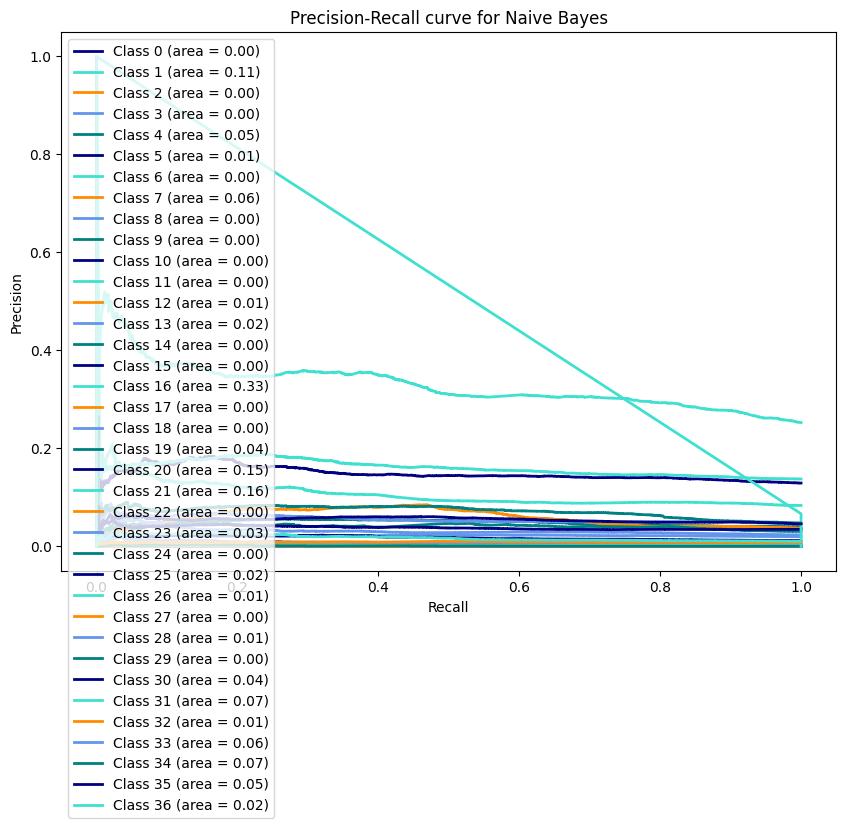

In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import plotly.express as px

# Veri yüklemesi
df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")

# Gereksiz sütunları çıkar
df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis=1)

# Tarih formatını düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split()[0])

# Tarih formatını yıl olarak düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split('-')[0])

# 2014 verilerini seç
df_2014 = df[df["Dates"] == '2014']

# Kategorik değişkenleri sayısal değerlere dönüştür
df_2014['Category'] = df_2014['Category'].astype('category')
df_2014['Category_code'] = df_2014['Category'].cat.codes

# Veriyi ölçeklendir
scaler = MinMaxScaler()
scaler.fit(df_2014[['X', 'Y']])
df_2014[['X_scaled', 'Y_scaled']] = scaler.transform(df_2014[['X', 'Y']])

# Naive Bayes modeli oluştur
nb = GaussianNB()
nb.fit(df_2014[['X_scaled', 'Y_scaled']], df_2014['Category_code'])
df_2014['predicted_category'] = nb.predict(df_2014[['X_scaled', 'Y_scaled']])

# Model değerlendirme
y_true = df_2014['Category_code']
y_pred = df_2014['predicted_category']

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_true, y_pred)
class_report = classification_report(y_true, y_pred, target_names=df_2014['Category'].cat.categories)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")
print("\nConfusion Matrix:\n", conf_matrix)
print("\nClassification Report:\n", class_report)


y_true = label_binarize(df_2014['Category_code'], classes=np.arange(len(df_2014['Category'].cat.categories)))
y_scores = nb.predict_proba(df_2014[['X_scaled', 'Y_scaled']])

n_classes = y_true.shape[1]

# Precision ve recall hesaplamaları
precision = dict()
recall = dict()
average_precision = dict()
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_true[:, i], y_scores[:, i])
    average_precision[i] = average_precision_score(y_true[:, i], y_scores[:, i])

# Precision-Recall eğrilerini çizme
plt.figure(figsize=(10, 7))
colors = cycle(['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal'])

for i, color in zip(range(n_classes), colors):
    plt.plot(recall[i], precision[i], color=color, lw=2,
             label=f'Class {i} (area = {average_precision[i]:0.2f})')

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall curve for Naive Bayes')
plt.legend(loc="best")
plt.show()


In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import plotly.express as px

# Veri yüklemesi
df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")

# Gereksiz sütunları çıkar
df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis=1)

# Tarih formatını düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split()[0])

# Tarih formatını yıl olarak düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split('-')[0])

# 2014 verilerini seç
df_2014 = df[df["Dates"] == '2014']

# Kategorik değişkenleri sayısal değerlere dönüştür
df_2014['Category'] = df_2014['Category'].astype('category')
df_2014['Category_code'] = df_2014['Category'].cat.codes

# Veriyi ölçeklendir
scaler = MinMaxScaler()
scaler.fit(df_2014[['X', 'Y']])
df_2014[['X_scaled', 'Y_scaled']] = scaler.transform(df_2014[['X', 'Y']])

# Rastgele Orman modeli oluştur
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(df_2014[['X_scaled', 'Y_scaled']], df_2014['Category_code'])
df_2014['predicted_category'] = rf.predict(df_2014[['X_scaled', 'Y_scaled']])

# Model değerlendirme
y_true = df_2014['Category_code']
y_pred = df_2014['predicted_category']

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_true, y_pred)
class_report = classification_report(y_true, y_pred, target_names=df_2014['Category'].cat.categories)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")
print("\nConfusion Matrix:\n", conf_matrix)
print("\nClassification Report:\n", class_report)

# Haritayı çiz
figure = px.scatter_mapbox(df_2014, lat='Y', lon='X',
                           center=dict(lat=37.8, lon=-122.4),
                           zoom=9,
                           opacity=0.9,
                           mapbox_style='stamen-terrain',
                           color='predicted_category',
                           title='San Francisco Crime Districts (Random Forest)',
                           width=1100,
                           height=700,
                           hover_data=['predicted_category', 'Category', 'Y', 'X'])

figure.show()

<ipython-input-38-ab22be6418bd>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-38-ab22be6418bd>:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-38-ab22be6418bd>:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-38-ab22

Accuracy: 0.47371800016050075
Precision: 0.469547259677508
Recall: 0.47371800016050075
F1 Score: 0.44864088689840426

Confusion Matrix:
 [[  22   14    0 ...    8    2    2]
 [   1 2474    0 ...   76   97   30]
 [   0    0    0 ...    0    0    0]
 ...
 [   2  130    0 ... 1752   37   10]
 [   1  293    0 ...   46  539   15]
 [   2  124    0 ...   11   35  143]]

Classification Report:
                              precision    recall  f1-score   support

                      ARSON       0.61      0.19      0.29       115
                    ASSAULT       0.37      0.40      0.38      6254
                 BAD CHECKS       0.00      0.00      0.00        12
                    BRIBERY       0.00      0.00      0.00        26
                   BURGLARY       0.56      0.39      0.46      3006
         DISORDERLY CONDUCT       0.32      0.11      0.16       171
DRIVING UNDER THE INFLUENCE       0.44      0.17      0.24       184
              DRUG/NARCOTIC       0.34      0.35      0.3

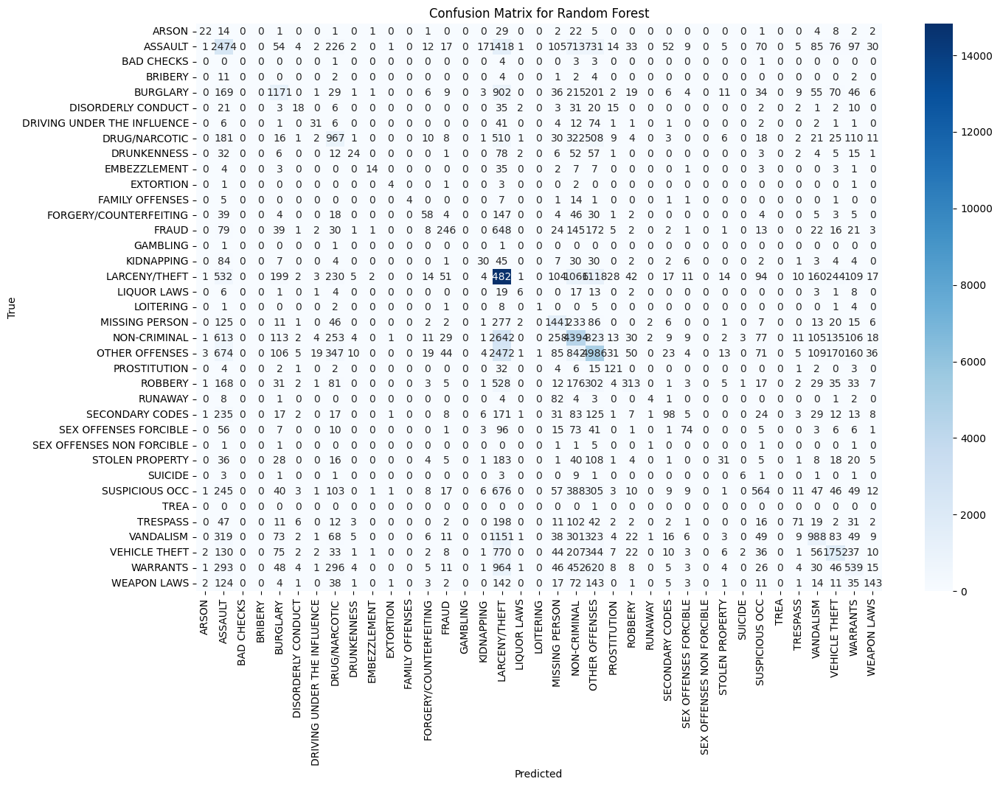

In [ ]:


# Karmaşıklık Matrisini Görselleştir
plt.figure(figsize=(15, 10))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=df_2014['Category'].cat.categories,
            yticklabels=df_2014['Category'].cat.categories)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix for Random Forest')
plt.show()


In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import plotly.express as px


df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")


df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis=1)


df["Dates"] = df["Dates"].apply(lambda x: x.split()[0])


df["Dates"] = df["Dates"].apply(lambda x: x.split('-')[0])


df_2014 = df[df["Dates"] == '2014']


df_2014['Category'] = df_2014['Category'].astype('category')
df_2014['Category_code'] = df_2014['Category'].cat.codes


scaler = MinMaxScaler()
scaler.fit(df_2014[['X', 'Y']])
df_2014[['X_scaled', 'Y_scaled']] = scaler.transform(df_2014[['X', 'Y']])


dt = DecisionTreeClassifier(random_state=42)
dt.fit(df_2014[['X_scaled', 'Y_scaled']], df_2014['Category_code'])
df_2014['predicted_category'] = dt.predict(df_2014[['X_scaled', 'Y_scaled']])


y_true = df_2014['Category_code']
y_pred = df_2014['predicted_category']

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_true, y_pred)
class_report = classification_report(y_true, y_pred, target_names=df_2014['Category'].cat.categories)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")
print("\nConfusion Matrix:\n", conf_matrix)
print("\nClassification Report:\n", class_report)




<ipython-input-42-ec34af89192c>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-ec34af89192c>:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-ec34af89192c>:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-42-ec34

Accuracy: 0.47371800016050075
Precision: 0.49404481493642316
Recall: 0.47371800016050075
F1 Score: 0.4428571701623007

Confusion Matrix:
 [[  44   13    0 ...    3    1    2]
 [   4 3125    0 ...   28   62   18]
 [   0    0    2 ...    0    0    0]
 ...
 [   9  220    0 ... 1363   18    2]
 [   5  380    0 ...   26  368    4]
 [   3  161    0 ...    8   23  107]]

Classification Report:
                              precision    recall  f1-score   support

                      ARSON       0.39      0.38      0.39       115
                    ASSAULT       0.35      0.50      0.41      6254
                 BAD CHECKS       0.50      0.17      0.25        12
                    BRIBERY       0.00      0.00      0.00        26
                   BURGLARY       0.49      0.52      0.51      3006
         DISORDERLY CONDUCT       0.31      0.18      0.22       171
DRIVING UNDER THE INFLUENCE       0.38      0.27      0.32       184
              DRUG/NARCOTIC       0.33      0.40      0.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



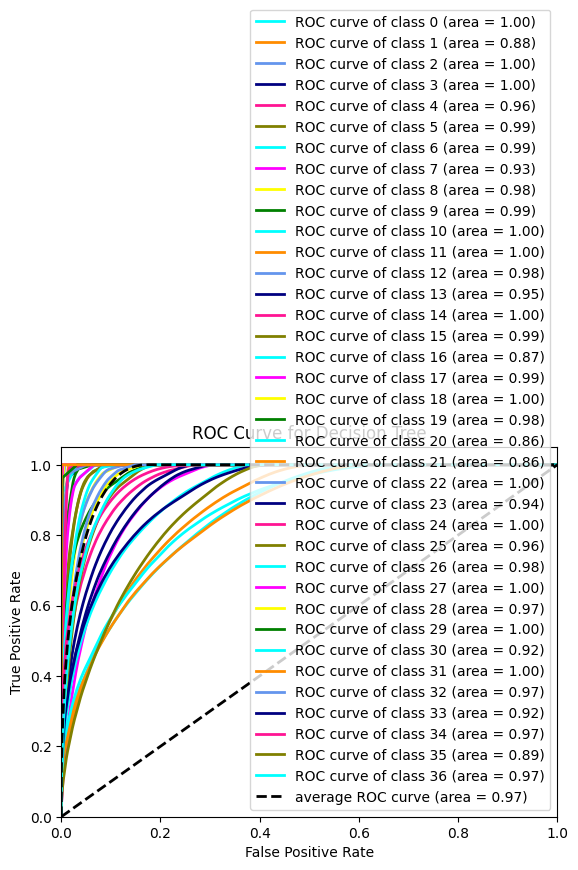

In [ ]:


# ROC eğrisi için verileri hazırlama
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Ortalama ROC eğrisi ve AUC
fpr["micro"], tpr["micro"], _ = roc_curve(y.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# ROC eğrisini çizme
plt.figure()
colors = cycle(['aqua', 'darkorange', 'cornflowerblue', 'navy', 'deeppink', 'olive', 'cyan', 'magenta', 'yellow', 'green'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC curve of class {i} (area = {roc_auc[i]:0.2f})')

plt.plot(fpr["micro"], tpr["micro"], color='black', lw=2, linestyle='--',
         label=f'average ROC curve (area = {roc_auc["micro"]:0.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Decision Tree')
plt.legend(loc="lower right")
plt.show()


In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import plotly.express as px

# Veri yüklemesi
df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")

# Gereksiz sütunları çıkar
df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis=1)

# Tarih formatını düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split()[0])

# Tarih formatını yıl olarak düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split('-')[0])

# 2014 verilerini seç
df_2014 = df[df["Dates"] == '2014']

# Kategorik değişkenleri sayısal değerlere dönüştür
df_2014['Category'] = df_2014['Category'].astype('category')
df_2014['Category_code'] = df_2014['Category'].cat.codes

# Veriyi ölçeklendir
scaler = MinMaxScaler()
scaler.fit(df_2014[['X', 'Y']])
df_2014[['X_scaled', 'Y_scaled']] = scaler.transform(df_2014[['X', 'Y']])

# SVM modeli oluştur
svm_model = SVC(kernel='rbf', random_state=42)
svm_model.fit(df_2014[['X_scaled', 'Y_scaled']], df_2014['Category_code'])
df_2014['predicted_category'] = svm_model.predict(df_2014[['X_scaled', 'Y_scaled']])

# Model değerlendirme
y_true = df_2014['Category_code']
y_pred = df_2014['predicted_category']

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_true, y_pred)
class_report = classification_report(y_true, y_pred, target_names=df_2014['Category'].cat.categories)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")
print("\nConfusion Matrix:\n", conf_matrix)
print("\nClassification Report:\n", class_report)




<ipython-input-44-1ee6bedff125>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-44-1ee6bedff125>:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-44-1ee6bedff125>:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-44-1ee6

Accuracy: 0.2651606345130139
Precision: 0.13171925440515098
Recall: 0.2651606345130139
F1 Score: 0.13490508552032807

Confusion Matrix:
 [[0 0 0 ... 0 0 0]
 [0 5 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 2 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

Classification Report:
                              precision    recall  f1-score   support

                      ARSON       0.00      0.00      0.00       115
                    ASSAULT       0.42      0.00      0.00      6254
                 BAD CHECKS       0.00      0.00      0.00        12
                    BRIBERY       0.00      0.00      0.00        26
                   BURGLARY       0.00      0.00      0.00      3006
         DISORDERLY CONDUCT       0.00      0.00      0.00       171
DRIVING UNDER THE INFLUENCE       0.00      0.00      0.00       184
              DRUG/NARCOTIC       0.00      0.00      0.00      2767
                DRUNKENNESS       0.00      0.00      0.00       301
               EMBEZZLEMENT

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



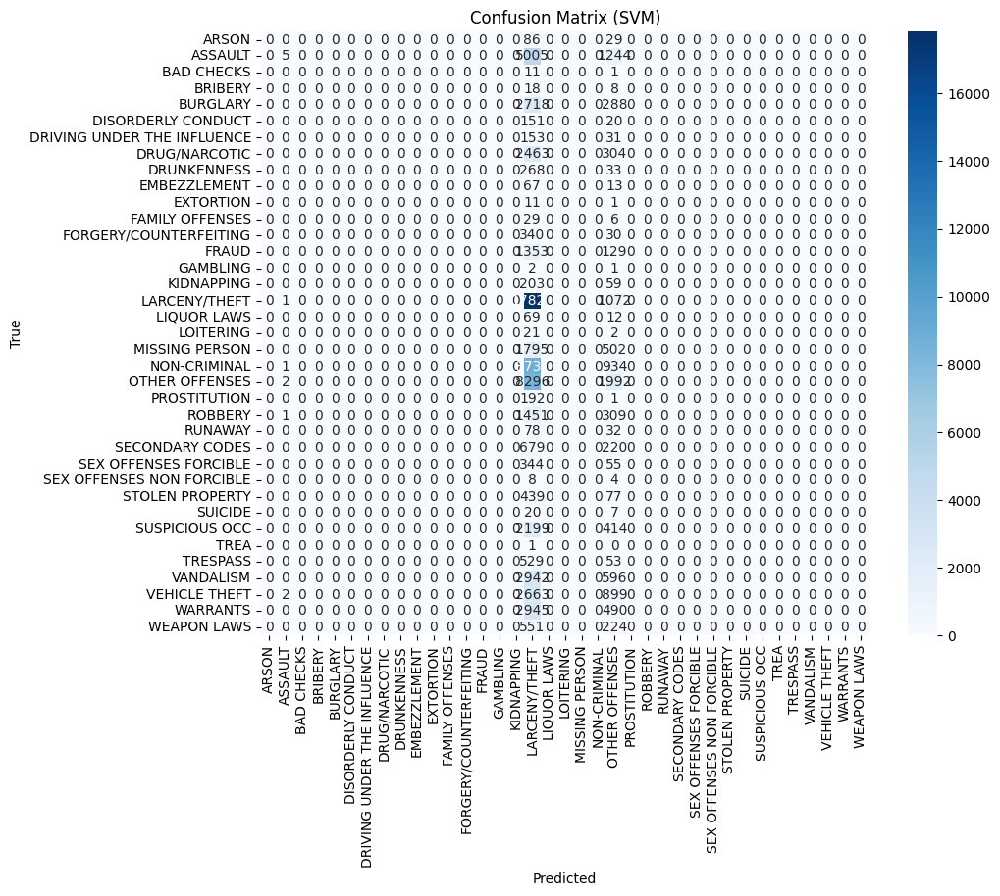

In [ ]:

# Karmaşıklık Matrisini Görselleştirme
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=df_2014['Category'].cat.categories, yticklabels=df_2014['Category'].cat.categories)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix (SVM)')
plt.show()

<ipython-input-46-2e7ecffdb22e>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-46-2e7ecffdb22e>:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-46-2e7ecffdb22e>:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-46-2e7e

Accuracy: 0.26201749458309925
Precision: 0.09596558248787238
Recall: 0.26201749458309925
F1 Score: 0.13576114089848712

Confusion Matrix:
 [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

Classification Report:
                              precision    recall  f1-score   support

                      ARSON       0.00      0.00      0.00       115
                    ASSAULT       0.00      0.00      0.00      6254
                 BAD CHECKS       0.00      0.00      0.00        12
                    BRIBERY       0.00      0.00      0.00        26
                   BURGLARY       0.00      0.00      0.00      3006
         DISORDERLY CONDUCT       0.00      0.00      0.00       171
DRIVING UNDER THE INFLUENCE       0.00      0.00      0.00       184
              DRUG/NARCOTIC       0.00      0.00      0.00      2767
                DRUNKENNESS       0.00      0.00      0.00       301
               EMBEZZLEME

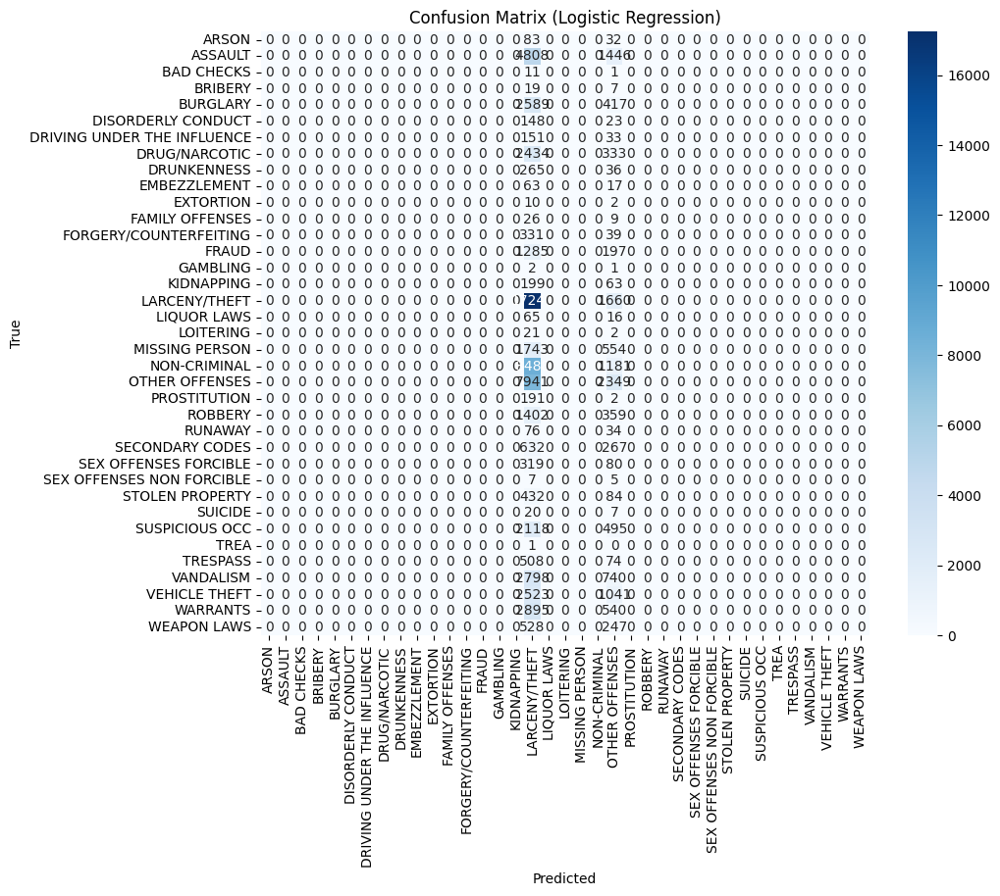

In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
import plotly.express as px

# Veri yüklemesi
df = pd.read_csv("/content/drive/MyDrive/Classroom/train (1).csv")

# Gereksiz sütunları çıkar
df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis=1)

# Tarih formatını düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split()[0])

# Tarih formatını yıl olarak düzenle
df["Dates"] = df["Dates"].apply(lambda x: x.split('-')[0])

# 2014 verilerini seç
df_2014 = df[df["Dates"] == '2014']

# Kategorik değişkenleri sayısal değerlere dönüştür
df_2014['Category'] = df_2014['Category'].astype('category')
df_2014['Category_code'] = df_2014['Category'].cat.codes

# Veriyi ölçeklendir
scaler = MinMaxScaler()
scaler.fit(df_2014[['X', 'Y']])
df_2014[['X_scaled', 'Y_scaled']] = scaler.transform(df_2014[['X', 'Y']])

# Lojistik Regresyon modeli oluştur
lr = LogisticRegression(max_iter=1000, random_state=42)
lr.fit(df_2014[['X_scaled', 'Y_scaled']], df_2014['Category_code'])
df_2014['predicted_category'] = lr.predict(df_2014[['X_scaled', 'Y_scaled']])

# Model değerlendirme
y_true = df_2014['Category_code']
y_pred = df_2014['predicted_category']

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_true, y_pred)
class_report = classification_report(y_true, y_pred, target_names=df_2014['Category'].cat.categories)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")
print("\nConfusion Matrix:\n", conf_matrix)
print("\nClassification Report:\n", class_report)

import seaborn as sns
import matplotlib.pyplot as plt

# Karmaşıklık Matrisini Görselleştirme
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=df_2014['Category'].cat.categories, yticklabels=df_2014['Category'].cat.categories)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix (Logistic Regression)')
plt.show()



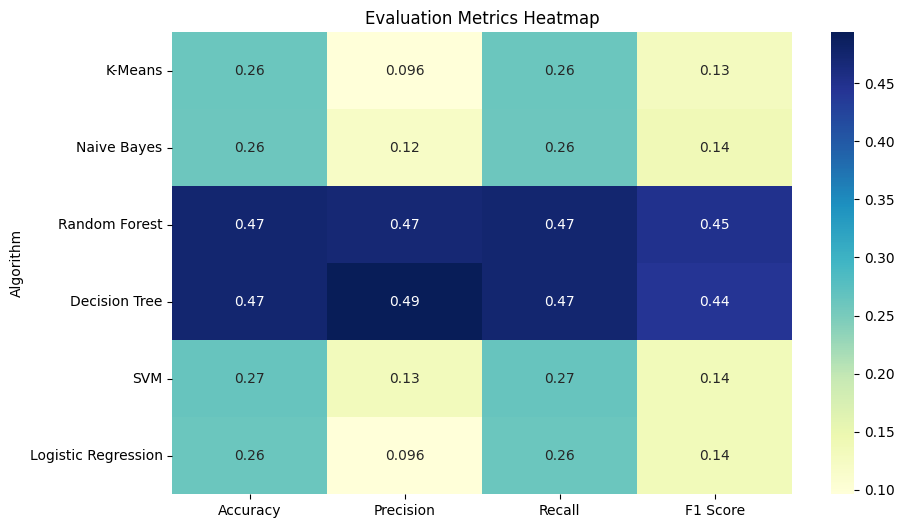

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

data = {
    "Algorithm": ["K-Means", "Naive Bayes", "Random Forest", "Decision Tree", "SVM", "Logistic Regression"],
    "Accuracy": [0.262, 0.260, 0.474, 0.474, 0.265, 0.262],
    "Precision": [0.096, 0.120, 0.470, 0.494, 0.132, 0.096],
    "Recall": [0.262, 0.260, 0.474, 0.474, 0.265, 0.262],
    "F1 Score": [0.130, 0.139, 0.449, 0.443, 0.135, 0.136]
}

df = pd.DataFrame(data)

plt.figure(figsize=(10, 6))
heatmap = sns.heatmap(df.set_index("Algorithm"), annot=True, cmap="YlGnBu")
heatmap.set_title("Evaluation Metrics Heatmap")
plt.show()


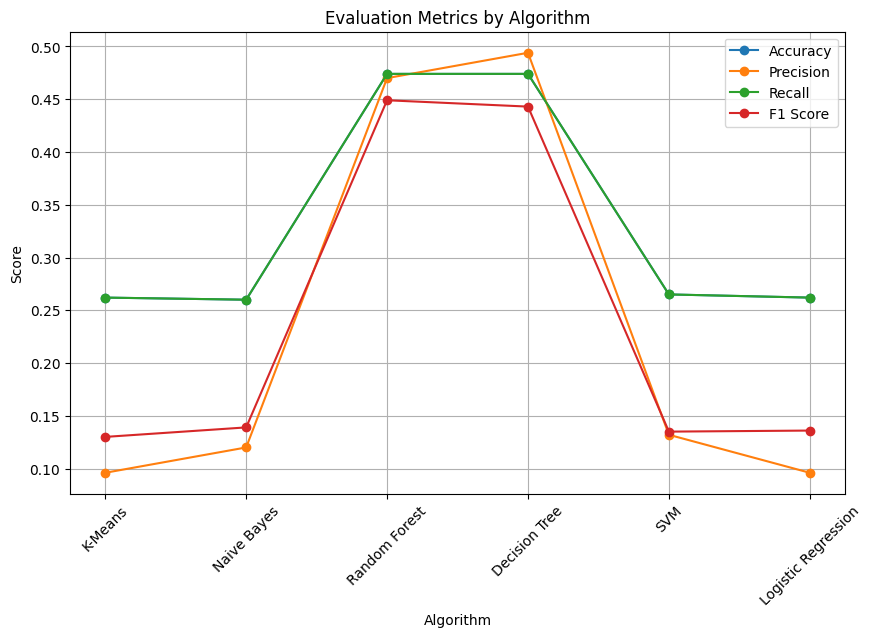

In [ ]:
plt.figure(figsize=(10, 6))

for metric in ["Accuracy", "Precision", "Recall", "F1 Score"]:
    plt.plot(df["Algorithm"], df[metric], marker='o', label=metric)

plt.title("Evaluation Metrics by Algorithm")
plt.xlabel("Algorithm")
plt.ylabel("Score")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()
